<a href="https://colab.research.google.com/github/DaniDelgon/Double_Pendulum/blob/main/dif.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Resolución de ecuaciones diferenciales

Primero vamos a intentar realizar todos los métodos para un probema simple, como es la resolución del oscilador armónico simple aplicado a un péndulo simple.

Luego, intentaremos aplicar todos estos métodos para resolver el problema del péndulo doble, el cual es más complejo de por sí.

##Método de Euler
Intentaremos resolver la ecuación diferencial para un péndulo simple para este método:

$l\ddot{\theta} + g\sin{\theta} = 0$

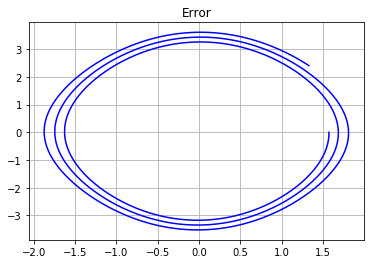

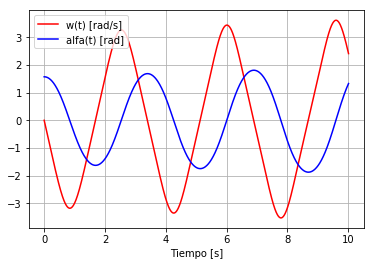

In [ ]:
from pylab import *
from numpy import *

#Definimos el método de Euler en una función de forma simple:

def Euler(f,xi,yi,h):
  yi1=yi+h*f(xi,yi)
  return yi1

#Definimos la ecuacíon diferencial del péndulo en una función: 

def pends(x,y):
  g=9.81
  #l=2
  deriv=zeros(2)
  deriv[0]=y[1]
  deriv[1]=-(g/l)*sin(y[0])
  return deriv

#Definimos el integrador general que sirve para cualquier función:

def integrador(func,metodo,xi,yi,xf,h):
  k=0
  X=[]  
  Y=[]
  X.append(xi)
  Y.append(yi)
  x=xi
  y=yi
  while x<xf:
    y=metodo(func,x,y,h)
    x=x+h
    X.append(x)
    Y.append(y)
  return array(X),array(Y)

#Definimos los valores iniciales del péndulo simple, y ploteamos el error que se produce, y el ángulo y la frecuencia de este con respecto al tiempo:

l=2
yi=array([pi/2.,0]) 
n=0.01
t,sol=integrador(pends,Euler,0.,yi,10.,n) 
title('Error')
plot(sol[:,0],sol[:,1],'-b')
grid()
show()

plot(t,sol[:,1],'-r',label='w(t) [rad/s]')
plot(t,sol[:,0],'-b',label='alfa(t) [rad]')
xlabel('Tiempo [s]')
legend()
grid()
show()

Luego ya, por mera curiosidad, animamos el péndulo simple (esta animación puede tardar un minuto en cargarse): 

In [ ]:
from matplotlib import animation, rc
from IPython.display import HTML

#Inicializamos los valores básicos que necesitamos:

fig, ax = subplots()
plt.close()
ax.set_xlim(( -l, l))
ax.set_ylim((-l, l))
line1, = ax.plot([], [], lw=2)
line2, = ax.plot([], [], lw=2)

#Dibujamos los ejes fijos x e y:

def init():
    line1.set_data(array([3/4.,0,0]), array([0,0,1]))      
    return (line1,)

#Y ahora la función la cual animamos
  
l1=linspace(0,l,2)  
def animate(i):
  y=-l1*cos(sol[i,0])
  x = (l1*sin(sol[i,0]))*(3/4.)
  line2.set_data(x,y)
  return (line2,)

anim = animation.FuncAnimation(fig, animate, init_func=init, frames=len(t), interval=10, blit=True)

rc('animation', html='jshtml')
anim

##Método de Runge-Kutta
Definimos la función de Runge-Kutta y vemos si funciona correctamente también.

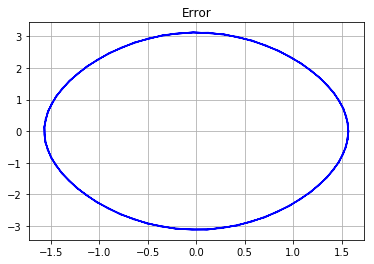

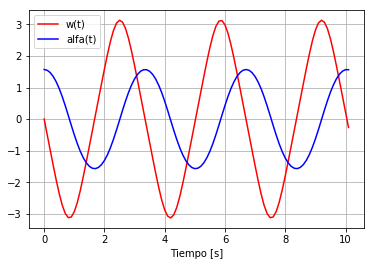

In [ ]:
#Defimos el método de Runge-Kutta

def Rung(f,xi,yi,h):
  K1=f(xi,yi)
  K2=f(xi+0.5*h,yi+0.5*h*K1)
  K3=f(xi+0.5*h,yi+0.5*h*K2)
  K4=f(xi+h,yi+h*K3)
  yi1=yi+(h/6.)*(K1+2*K2+2*K3+K4)
  return yi1

#Definimos los valores iniciales para este, y lo ploteamos:

l=2
yi=array([pi/2.,0]) 
n=0.1
t,sol=integrador(pends,Rung,0.,yi,10.,n) 

plot(sol[:,0],sol[:,1],'-b')
title('Error')
grid()
show()

plot(t,sol[:,1],'-r',label='w(t)')
plot(t,sol[:,0],'-b',label='alfa(t)')
xlabel('Tiempo [s]')
legend()
grid()
show()  

##Método predictor-corrector
Primero probamos con el método de Milne de cuarto orden:

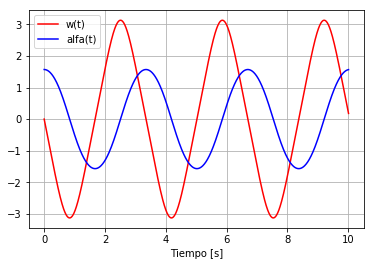

In [ ]:
#Primero definimos el método de Milne de cuarto orden:

def Milne(f,X,Y,h):
  yi1p=Y[len(Y)-4]+((4.*h)/3.)*(2*f(X[len(X)-1],Y[len(Y)-1])-f(X[len(X)-2],Y[len(Y)-2])+2*f(X[len(X)-2],Y[len(Y)-2]))
  yi1=Y[len(Y)-2]+(h/3.)*(f(X[len(X)-1]+h,yi1p)+4*f(X[len(X)-1],Y[len(Y)-1])+f(X[len(X)-2],Y[len(Y)-2]))
  return yi1

#Luego definimos un integrador diferente al que tenemos al princio, este integrador no necesita unos valores iniciales, solo la matriz de los n primeros valores obtenidos por Runge-Kutta o por Euler:

def integrador2(func,metodo,X,Y,xf,h):
  X=list(X)
  Y=list(Y)
  x=X[-1]
  while x<xf:
    y=metodo(func,X,Y,h)#,X,Y)
    x=X[-1]+h
    X.append(x)
    Y.append(y)
  return array(X),array(Y)

#Ahora combinamos los dos integradores para el método del predictor-corrector, ya que necesitamos los dos para este método, así definimos un integrador solo para los métodos predictor-corrector:
def Pred(n,func,metodo1,metodo2,xi,yi,xf,h):
  X,Y=integrador(func,metodo1,xi,yi,n*h+xi,h)
  t,sol=integrador2(func,metodo2,X,Y,xf,h)
  return t,sol

#Definimos los valores iniciales y ploteamos el resultado:

yi=array([pi/2.,0]) 
t,sol=Pred(4,pends,Rung,Milne,0,yi,10,0.01)

plot(t,sol[:,1],'-r',label='w(t)')
plot(t,sol[:,0],'-b',label='alfa(t)')
xlabel('Tiempo [s]')
legend()
grid()
show()  

#Péndulo doble
Definimos primero un integrador para dos variables. Primero lo resolvemos para el método de Runge-Kutta:

$\ddot\theta_1 =  
\frac {-g (2m_1+m_2)\sin\theta_1 
-m_2g \sin(\theta_1-2\theta_2) 
-2\sin(\theta_1 
-\theta_2)m_2(\dot\theta_2^2 l_2 
+\dot\theta_1^2 l_1\cos(\theta_1-\theta_2))} 
{l_1(2m_1+m_2-m_2\cos(2\theta_1 
-2\theta_2))}$

$\ddot\theta_2 = 
\frac {2 \sin(\theta_1 
- \theta_2) (\dot\theta_1^2 l_1 (m_1 + m_2) 
+ g(m_1 + m_2) \cos \theta_1 + \dot\theta_2^2 l_2 m_2 \cos(\theta_1 - \theta_2)) } {
l_2 (2 m_1 + m_2 - m_2 \cos(2 \theta_1 - 2 \theta_2))}$

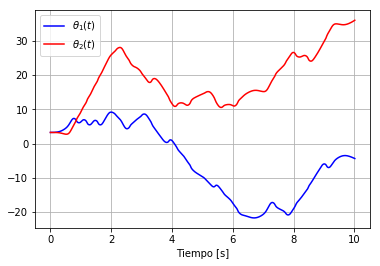

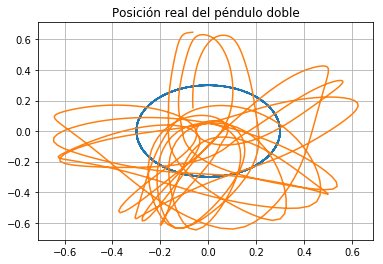

In [ ]:
#Definimos la función péndulo doble en una matriz de 4 filas, una para los dos ángulos y otra para las derivadas de los dos ángulos:

def pendobl(x,y):
  g=9.8
  deriv=zeros(4)
  deriv[0]=y[1]
  #deriv[1]=(-g*(2.*m1+m2)*sin(y[0])-m2*g*sin(y[0]-2.*y[2])-2.*sin(y[0]-y[2])*m2*((y[3]**2.)*l2+(y[1]**2.)*l1*cos(y[0]-y[2])))/(l1*(2.*m1+m2-m2*cos(2.*y[0]-2.*y[2])))
  deriv[1]=(cos(y[0]-y[2])*((g/l1)*sin(y[2])-(y[1]**(2))*sin(y[0]-y[2]))-(l2/l1)*(((m1/m2)+1)*(g/l2)*sin(y[0])+(y[3]**(2))*sin(y[0]-y[2])))/((m1/m2)+(sin(y[0]-y[2]))**2)
  deriv[2]=y[3]
  #deriv[3]=(2.*sin(y[0]-y[2])*((y[1]**2)*l1*(m1+m2)+g*(m1+m2)*cos(y[0])+(y[3]**2)*l2*m2*cos(y[0]-y[2])))/(l2*(2.*m1+m2-m2*cos(2.*y[0]-2.*y[2])))
  deriv[3]=(cos(y[0]-y[2])*(((m1/m2)+1)*(g/l2)*sin(y[0])+(y[3]**(2))*sin(y[0]-y[2]))-((m1/m2)+1)*(l1/l2)*((g/l1)*sin(y[2])-(y[1]**(2))*sin(y[0]-y[2])))/((m1/m2)+(sin(y[0]-y[2]))**(2))
  return deriv

#Definimos los valores iniciales y ploteamos:

m1=0.2
m2=0.3
l1=0.3
l2=0.35
yi=array([pi+0.1,0,pi+0.1,0])

t,sol=integrador(pendobl,Rung,0.,yi,10.,0.01)

#Para visualizar las frecuencias, quitar las baldosas de los siqguientes plots:

plot(t,sol[:,0],'b-',label=r'$\theta _{1}\left( t\right)$')
#plot(t,sol[:,1],'g-',label=r'$W_{1}\left( t\right) )$')
plot(t,sol[:,2],'r-',label=r'$\theta _{2}\left( t\right)$')
#plot(t,sol[:,3],'y-',label=r'$W_{2}\left( t\right) )$')
xlabel('Tiempo [s]')
legend()
grid()
show()

plot(l1*sin(sol[:,0]),-l1*cos(sol[:,0]))
plot(l1*sin(sol[:,0])+l2*sin(sol[:,2]),-l1*cos(sol[:,0])-l2*cos(sol[:,2]))
title('Posición real del péndulo doble')
grid()
show()
  

In [ ]:
from matplotlib import animation, rc
from IPython.display import HTML

l1=0.3
l2=0.35
l=l1+l2

#Inicializamos los valores iniciales que necesitamos para este módulo:

fig, ax = subplots()
plt.close()
ax.set_xlim(( -l1-l2, l1+l2))
ax.set_ylim((-l1-l2, l1+l2))
line1, = ax.plot([], [], lw=2)
line2, = ax.plot([], [], lw=2)
line3, = ax.plot([], [], lw=2)
line4, = ax.plot([], [], lw=2)

#Para esta animación quitamos la visualización fija de los ejes x e y.

def init():
    #line1.set_data(array([l*(3/4.),0,0]), array([0,0,l*1]))      
    return (line1,)

#Y ahora ploteamos las funciones que animamos secuencialmente, y ploteamos la animación:
  
l1=linspace(0,l1,2)  
l2=linspace(0,l2,2)
k=30
def animate(i):
  #print((i*100)/len(t))
  sys.stdout.write('\r'+str('Cargando %.1f%%'%((i*100)/len(t))))
  sys.stdout.flush()
  y2=-l1[-1]*cos(sol[i,0])-l2*cos(sol[i,2])
  x2=(l1[-1]*sin(sol[i,0])+l2*sin(sol[i,2]))*(3./4.)
  y1=-l1*cos(sol[i,0])
  x1=l1*sin(sol[i,0])*(3./4.)
  if i<=k:
    y3=-l1[-1]*cos(sol[0:i,0])-l2[-1]*cos(sol[0:i,2])
    x3=(l1[-1]*sin(sol[0:i,0])+l2[-1]*sin(sol[0:i,2]))*(3./4.)
  else:
    y3=-l1[-1]*cos(sol[i-k:i+1,0])-l2[-1]*cos(sol[i-k:i+1,2])
    x3=(l1[-1]*sin(sol[i-k:i+1,0])+l2[-1]*sin(sol[i-k:i+1,2]))*(3./4.)
  line3.set_data(x1,y1)
  line2.set_data(x2,y2)
  line4.set_data(x3,y3)
  return (line2,line3,line4,)

anim = animation.FuncAnimation(fig, animate, init_func=init, frames=len(t), interval=20, blit=True)

rc('animation', html='jshtml')
anim

Cargando 99.9%

Ahora ploteamos el péndulo doble para el método de Euler:

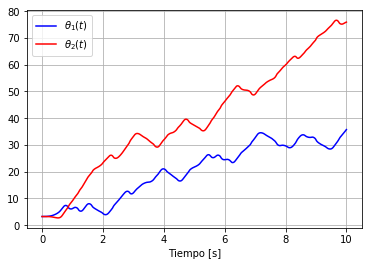

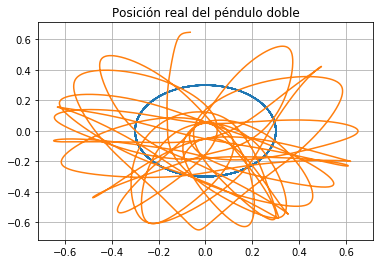

In [ ]:
#Definimos los valores iniciales, aplicamnos la función y ploteamos, veremos que la gráfica nos saldrá muy diferente a la anterior, esto es debido a que estamos r5esolviendo un sistema caótico:

m1=0.2
m2=0.3
l1=0.3
l2=0.35
yi=array([pi+0.1,0,pi+0.1,0])

t,sol=integrador(pendobl,Euler,0.,yi,10.,0.001)

plot(t,sol[:,0],'b-',label=r'$\theta _{1}\left( t\right)$')
#plot(t,sol[:,1],'g-',label=r'$W_{1}\left( t\right) )$')
plot(t,sol[:,2],'r-',label=r'$\theta _{2}\left( t\right)$')
#plot(t,sol[:,3],'y-',label=r'$W_{2}\left( t\right) )$')
xlabel('Tiempo [s]')
legend()
grid()
show()

title('Posición real del péndulo doble')
plot(l1*sin(sol[:,0]),-l1*cos(sol[:,0]))
plot(l1*sin(sol[:,0])+l2*sin(sol[:,2]),-l1*cos(sol[:,0])-l2*cos(sol[:,2]))
grid()
show()
  

Ahora aplicamos el método del predictor corrector para el péndulo doble, con el método de Milne de cuarto orden, y cogiendo los tres primeros valores por el método de Runge-Kutta:

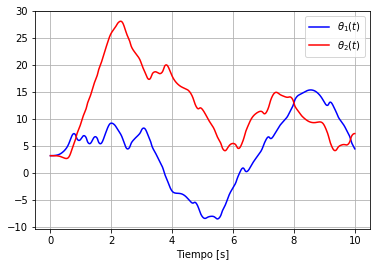

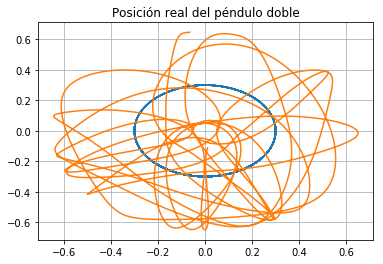

In [ ]:
#Definimos los valores iniciales, aplicamnos la función y ploteamos, veremos que la gráfica nos saldrá muy diferente a la anterior, esto es debido a que estamos r5esolviendo un sistema caótico:

m1=0.2
m2=0.3
l1=0.3
l2=0.35
yi=array([pi+0.1,0,pi+0.1,0])

t,sol=Pred(4,pendobl,Rung,Milne,0,yi,10,0.001)

plot(t,sol[:,0],'b-',label=r'$\theta _{1}\left( t\right)$')
#plot(t,sol[:,1],'g-',label=r'$W_{1}\left( t\right) )$')
plot(t,sol[:,2],'r-',label=r'$\theta _{2}\left( t\right)$')
#plot(t,sol[:,3],'y-',label=r'$W_{2}\left( t\right) )$')
legend()
xlabel('Tiempo [s]')
grid()
show()

title('Posición real del péndulo doble')
plot(l1*sin(sol[:,0]),-l1*cos(sol[:,0]))
plot(l1*sin(sol[:,0])+l2*sin(sol[:,2]),-l1*cos(sol[:,0])-l2*cos(sol[:,2]))
grid()
show()